# World Data League 2021
## Notebook Template

This notebook is one of the mandatory deliverables when you submit your solution (alongside the video pitch). Its structure follows the WDL evaluation criteria and it has dedicated cells where you can add descriptions. Make sure your code is readable as it will be the only technical support the jury will have to evaluate your work.

The notebook must:

*   💻 have all the code that you want the jury to evaluate
*   🧱 follow the predefined structure
*   📄 have markdown descriptions where you find necessary
*   👀 be saved with all the output that you want the jury to see
*   🏃‍♂️ be runnable??


## Introduction
We are DataChics and we have choosen the first challenge which is The Churn and retention model for public transportation. The main goal is to identify churn profiles and drivers, propose measures to win back lost segments
and their expected impact.

Firstly, we have performed and explorative analysis of the available data to have some insights. Secondly, we have identified the segments that have experienced a greater change, either positive or negative. For this purpose we have proposed some methods to measure the changes of those segments. Finally we have suggested some proposals to win back lost segments in a inclusive and sustainable way. 

To check for additional files check the following repo.
https://github.com/MariaJavierre/WDL

## Development
Start coding here! 🐱‍🏍

Don't hesitate to create markdown cells to include descriptions of your work where you see fit, as well as commenting your code.

We know that you know exactly where to start when it comes to crunching data and building models, but don't forget that WDL is all about social impact...so take that into consideration as well.

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


### Library Imports and installations

In [ ]:
!pip install geopandas

     |████████████████████████████████| 1.0MB 8.4MB/s 
     |████████████████████████████████| 6.5MB 19.3MB/s 
     |████████████████████████████████| 15.3MB 293kB/s 


In [ ]:
import pandas as pd
import plotly.express as px
import geopandas as gpd
%matplotlib inline
import matplotlib.pyplot as plt
import plotly.graph_objects as go

### Reading files

In [ ]:
Churn_OD = pd.read_csv('/content/drive/MyDrive/WDL/Churn_OD.txt', encoding = 'latin-1', sep = '|')
Churn_UsersProfile = pd.read_csv('/content/drive/MyDrive/WDL/Churn_UsersProfile.txt', encoding = 'latin-1', sep = '|')
geo_df = gpd.read_file('/content/drive/MyDrive/WDL/distritos_portugal.geojson')

### Geographic Analysis

In this section a geographic analysis of the average number of bus users will be carried out. This study will be focused first in a general way and then in a more specific way. That is to say, we will start with the districts until we arrive at an analysis by cities.

In [ ]:
Avg_users_by_Districy_Period = Churn_UsersProfile[['District_of_Origin','Period','Average_BusUsers_per_Day']].groupby(['District_of_Origin','Period']).sum('Average_BusUsers_per_Day').pivot_table(columns = 'Period', index = 'District_of_Origin')

In [ ]:
geo = geo_df.merge(Avg_users_by_Districy_Period, left_on = 'distrito', right_on = 'District_of_Origin', how = 'left').fillna(0)
geo.columns = ['cartodb_id','distrito','natcode','area','geometry','Average_BusUsers_per_Day_Before','Average_BusUsers_per_Day_After']
geo = geo.set_index('distrito')

/usr/local/lib/python3.7/dist-packages/pandas/core/reshape/merge.py:643: UserWarning:

merging between different levels can give an unintended result (1 levels on the left,2 on the right)



The following two graphs show the average number of bus users per district per day. The first one before COVID and the second one after it. We can see that from one period to the other the number of users has decreased, as expected. Although we can see that the distribution is the same, i.e. the regions with more users are still the same, i.e. Porto is still the region with the highest average number of users and Aveiro the lowest. 
The graphs are interactive, placing the mouse over each region you can visualize the data.

In [ ]:
fig = px.choropleth_mapbox(geo,
                           geojson=geo.geometry,
                           locations=geo.index,
                           color = geo.Average_BusUsers_per_Day_Before,
                           color_continuous_scale="Viridis",
                           title = 'Average Bus Users per day by district of origin BEFORE COVID',
                           center={"lat": 39.5, "lon": -9},
                           mapbox_style="open-street-map",
                           zoom=5)
fig.show()

In [ ]:
fig = px.choropleth_mapbox(geo,
                           geojson=geo.geometry,
                           locations=geo.index,
                           color = geo.Average_BusUsers_per_Day_After,
                           color_continuous_scale="Viridis",
                           title = 'Average Bus Users per day by district of origin AFTER COVID',
                           center={"lat": 39.5, "lon": -9},
                           mapbox_style="open-street-map",
                           zoom=5)
fig.show()

The following chart shows the number of users per city. The interactive graph allows you to compare data from one period to another.

In [ ]:
coor_pt = pd.read_csv('/content/drive/MyDrive/WDL/pt.csv')
map = Churn_UsersProfile.groupby(['District_of_Origin','County_of_Origin','Period']).sum('Average_BusUsers_per_Day')
map = Churn_UsersProfile.groupby(['District_of_Origin','County_of_Origin','Period']).sum('Average_BusUsers_per_Day')
map = map.reset_index()
mapa = map.merge(coor_pt[['city', 'lat', 'lng']], left_on = 'County_of_Origin', right_on = 'city')

In [ ]:
fig = px.scatter_mapbox(mapa, lat="lat", lon="lng", color="Average_BusUsers_per_Day", size = "Average_BusUsers_per_Day",
                  color_continuous_scale=px.colors.sequential.Viridis, size_max=20, zoom=5,
                  mapbox_style="carto-positron", animation_frame="Period")

fig.show()

The routes available in these regions will be analyzed. For this purpose, the following two graphs are shown. The first one plots the arrival and departure routes by district. The x-axis shows the origin routes and the y-axis shows the arrival routes. The size of the circle indicates the number of routes with that origin and destination. The second plots the same but instead of district by county.


In [ ]:
%cd /content/drive/MyDrive/WDL
from catscatter import catscatter

/content/drive/MyDrive/WDL


In [ ]:
District_of_Origin_to_destination = Churn_OD.groupby(['District_of_Origin', 'District_of_Public_Transportation']).count().sort_values(by='Region_of_Origin', ascending=False)
District_of_Origin_to_destination = District_of_Origin_to_destination.reset_index()

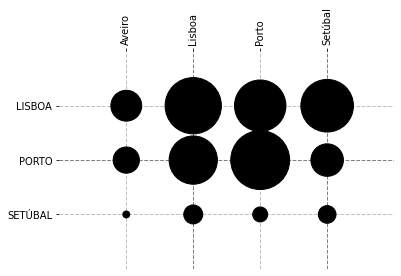

In [ ]:
catscatter(District_of_Origin_to_destination ,'District_of_Origin','District_of_Public_Transportation','Region_of_Origin', ratio=8)
plt.show()

Practically all the routes have destination Lisbon and Porto, which is logical because they are very large urban centers. Also within these districts is where there are more routes, as shown in the chart below. 

In [ ]:
County_of_Origin_to_destination = Churn_OD.groupby(['County_of_Origin', 'County_of_Public_Transportation']).count().sort_values(by='Region_of_Origin', ascending=False)
County_of_Origin_to_destination = County_of_Origin_to_destination.reset_index()

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.


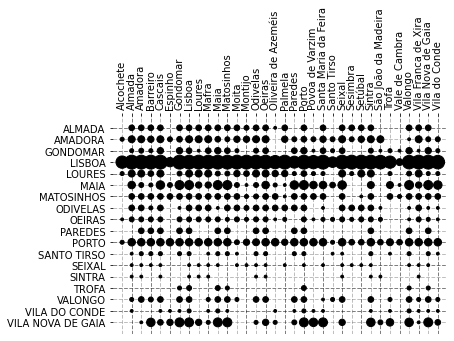

In [ ]:
catscatter(County_of_Origin_to_destination,'County_of_Origin','County_of_Public_Transportation','Region_of_Origin', ratio=8)
plt.show()

Now the graph above shows a more specific study of the routes, by point of origin to point of departure. The graph shows that the destination par excellence is Lisbon by far, followed by Porto. The origin is a bit uniform

The following two graphs show the origin either by district or by county according to the number of average bus users, before and after the COVID situation. Practically all origins have been reduced, mainly due to the decrease in the use of public transport.



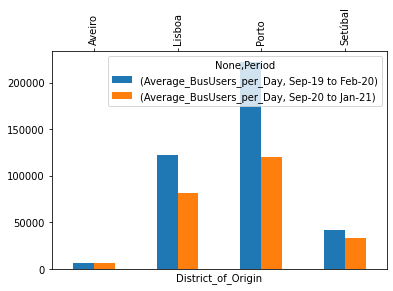

In [ ]:
Churn_UsersProfile.groupby(['District_of_Origin', 'Period']).sum('Average_BusUsers_per_Day').reset_index().pivot_table(columns = 'Period', index = 'District_of_Origin').plot.bar()

As the graph above shows, Porto was the origin which had a higher impact, followed by Lisbon. Setubal and Arebalo have undergone less change, probably for two reasons. They are less populated districts and with less urban center compared to Lisbon and Porto, and it is most likely that people have to move to the latter two cities and have no other option but the bus.

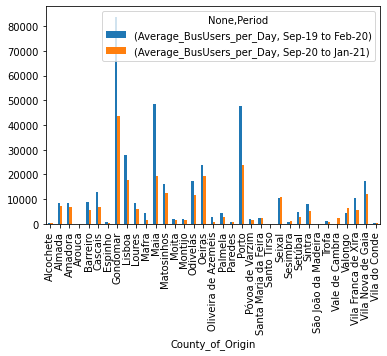

In [ ]:
Churn_UsersProfile.groupby(['County_of_Origin', 'Period']).sum('Average_BusUsers_per_Day').reset_index().pivot_table(columns = 'Period', index = 'County_of_Origin').plot.bar()

### Population Analysis

We will now analyze the sectors of the population, both by gender and by age.

The following graph shows the difference in bus users by age group and gender, before and after covid. as expected, the average usage has been reduced from one period to the next. And the reductions by sex are more or less equal in each age group, except for the 65 years old age group where male have considerably reduced their use.

In [ ]:
fig = px.bar(Churn_UsersProfile , x="AgeClassDescription", y="Average_BusUsers_per_Day", color="GenderDescription", barmode="group", facet_col="Period",
             title = 'Average Bus users per day by Sex and Age BEFORE and AFTER COVID',
             category_orders={"AgeClassDescription": ['15-24','25-34','35-44','45-54','55-64','65+'],
                              "Period": ["Sep-19 to Feb-20", "Sep-20 to Jan-21"],
                              "GenderDescription": ["Female", "Male"]})
fig.show()


The same as the previous graph will be reproduced but with district instead of gender.

In [ ]:
fig = px.bar(Churn_UsersProfile , x="AgeClassDescription", y="Average_BusUsers_per_Day", color="District_of_Origin", barmode="group", facet_col="Period",
             title = 'Average Bus Users per dat by age class and district BEFORE and AFTER COVID',
             category_orders={"AgeClassDescription": ['15-24','25-34','35-44','45-54','55-64','65+'],
                              "Period": ["Sep-19 to Feb-20", "Sep-20 to Jan-21"],
                              "District_of_Origin": ["Lisboa", "Setubal", 'Aveiro', 'Porto']})
fig.show()

Now the data will be shown by location and sex.

In [ ]:
Before = Churn_UsersProfile[Churn_UsersProfile['Period'] == 'Sep-19 to Feb-20']

fig = go.Figure()

fig.update_layout(
    template="simple_white",
    title = 'Average Users per day by district and sex BEFORE COVID',
    xaxis=dict(title_text="District_of_Origin"),
    yaxis=dict(title_text="Average_BusUsers_per_Day"),
    barmode="stack"
)

colors = ["#2A66DE", "#FFC32B"]

for r, c in zip(Before.GenderDescription.unique(), colors):
    plot_df = Before[Before.GenderDescription == r]
    fig.add_trace(
        go.Bar(x=[plot_df.District_of_Origin, plot_df.AgeClassDescription], y= plot_df.Average_BusUsers_per_Day, name=r, marker_color=c),
    )

fig

In [ ]:
After = Churn_UsersProfile[Churn_UsersProfile['Period'] == 'Sep-20 to Jan-21']

fig = go.Figure()

fig.update_layout(
    template="simple_white",
    title = 'Average Users per day by district and sex AFTER COVID',
    xaxis=dict(title_text="District_of_Origin"),
    yaxis=dict(title_text="Average_BusUsers_per_Day"),
    barmode="stack"
)

colors = ["#2A66DE", "#FFC32B"]

for r, c in zip(After.GenderDescription.unique(), colors):
    plot_df = After[After.GenderDescription == r]
    fig.add_trace(
        go.Bar(x=[plot_df.District_of_Origin, plot_df.AgeClassDescription], y= plot_df.Average_BusUsers_per_Day, name=r, marker_color=c),
    )

fig

In [ ]:
Percentual_change_routes = Churn_UsersProfile[['Average_BusUsers_per_Day', 'Period', 'Region_of_Origin']].groupby(['Region_of_Origin', 'Period']).sum('Average_BusUsers_per_Day').pivot_table(index = 'Region_of_Origin', columns = 'Period')
Percentual_change_routes = Percentual_change_routes.reset_index()
Percentual_change_routes.columns = [('Region_of_Origin'),('Sep-19 to Feb-20'),('Sep-20 to Jan-21')]
Percentual_change_routes['Change_per'] = 100 * (Percentual_change_routes['Sep-20 to Jan-21'] - Percentual_change_routes['Sep-19 to Feb-20'] )/ Percentual_change_routes['Sep-19 to Feb-20']
Percentual_change_routes

,Region_of_Origin,Sep-19 to Feb-20,Sep-20 to Jan-21,Change_per
0,R1 - AM Lisboa,163937.945325,114784.671784,-29.982853
1,R2 - AM Porto,228580.130223,126673.023813,-44.582662


In [ ]:
Percentual_change_District_Origin = Churn_UsersProfile[['Average_BusUsers_per_Day', 'Period', 'District_of_Origin']].groupby(['District_of_Origin', 'Period']).sum('Average_BusUsers_per_Day').pivot_table(index = 'District_of_Origin', columns = 'Period')
Percentual_change_District_Origin = Percentual_change_District_Origin.reset_index()
Percentual_change_District_Origin.columns = [('District_of_Origin'),('Sep-19 to Feb-20'),('Sep-20 to Jan-21')]
Percentual_change_District_Origin['Change_per'] = 100 * (Percentual_change_District_Origin['Sep-20 to Jan-21'] - Percentual_change_District_Origin['Sep-19 to Feb-20'] )/ Percentual_change_District_Origin['Sep-19 to Feb-20']
Percentual_change_District_Origin

,District_of_Origin,Sep-19 to Feb-20,Sep-20 to Jan-21,Change_per
0,Aveiro,6041.956609,5963.683255,-1.295497
1,Lisboa,122085.933172,81057.911693,-33.605855
2,Porto,222538.173614,120709.340558,-45.757917
3,Setúbal,41852.012153,33726.760091,-19.414245


### **Identifying Critical Segments**
In this section we will try to identify the segments that have suffered a greater change (either positive or negative) regarding the average users per day. As a first step we calculate the overall change between periods. 

In [ ]:
pre_covid= Churn_UsersProfile [Churn_UsersProfile["Period"]=="Sep-19 to Feb-20"]
post_covid= Churn_UsersProfile [Churn_UsersProfile["Period"]=="Sep-20 to Jan-21"]

In [ ]:
pre_covid_gender = pre_covid.groupby(["GenderDescription"]).sum("Average_BusUsers_per_Day")
post_covid_gender = post_covid.groupby(["GenderDescription"]).sum("Average_BusUsers_per_Day")

In [ ]:
sum_pre_covid= pre_covid_gender ["Average_BusUsers_per_Day"].sum()
sum_post_covid= post_covid_gender ["Average_BusUsers_per_Day"].sum()
change = (sum_post_covid -sum_pre_covid) * 100 / sum_pre_covid
change

-38.484948684236386

The variable *change* reprensent the overall change in average users per day between the two periods. As shown above, the overall change is a loss of almost 40% of users. This value is what we are going to assume is the average change due to the pandemic and so any value that is below or above *change* is going to be analized. 

We are going to compare this value with every porcentual change for every route. If most of the changes follow the general change, then we can explore the outliers as the groups that have either grown or decreased in number. An image is shown below to illustrate this concept (numbers and outliers are fake, placed just to give a graphical explanation). The bold red line represent the average change due to the pandemic while the ligher red ones reprensent a deviation from this average that we consider that still represents the average. Outliers are the changes we should analize in depth.

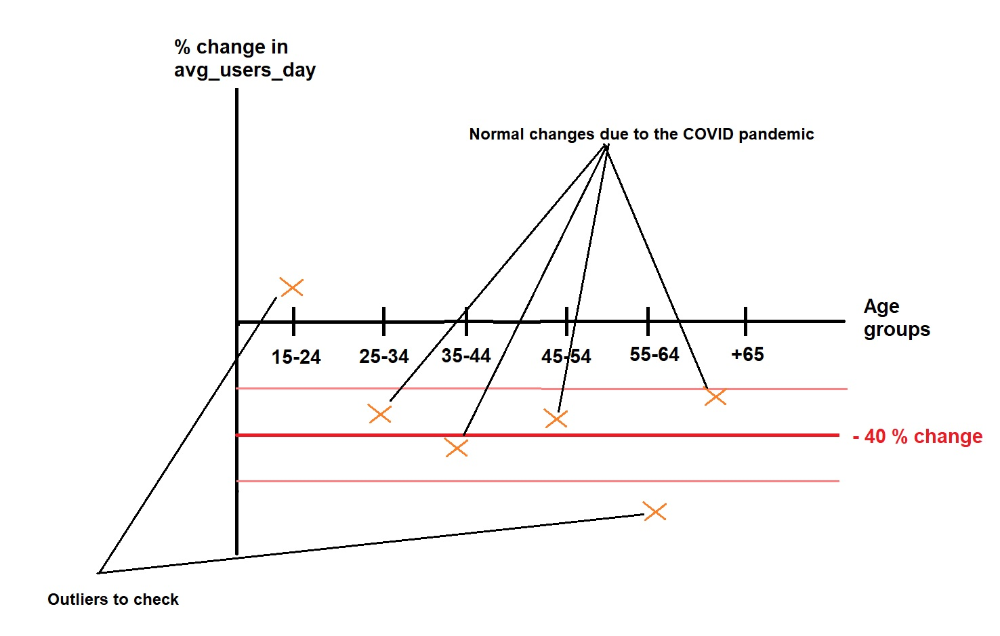

In [ ]:
from IPython.display import display, Image
display(Image(filename='/content/drive/MyDrive/WDL/poc_data.jpg'))

However, first we need to check if the changes across one group (either by gender, by age...) follow the same general behaviour. For this concept to work we need that the majortity of the points to behave as the mean in order to find outliers, if they don't then won't be able to ascertain that the outliers are in fact outliers because every point will be an outlier. 

In order to check this, we build a table with the percentage changes by gender and age group and check whether for each group the average change is around -40% plus an interval ( +- 10%?).

In [ ]:
B = Churn_UsersProfile[Churn_UsersProfile['Period'] == 'Sep-19 to Feb-20'].pivot_table(values ='Average_BusUsers_per_Day',index='District_of_Origin', columns=['GenderDescription','AgeClassDescription'])
A = Churn_UsersProfile[Churn_UsersProfile['Period'] == 'Sep-20 to Jan-21'].pivot_table(values ='Average_BusUsers_per_Day',index='District_of_Origin', columns=['GenderDescription','AgeClassDescription'])

In [ ]:
A.columns = ['F15-24','F25-34','F35-44','F45-54','F55-64','F65+', 'M15-24','M25-34','M35-44','M45-54','M55-64','M65+']
B.columns = ['F15-24','F25-34','F35-44','F45-54','F55-64','F65+', 'M15-24','M25-34','M35-44','M45-54','M55-64','M65+']
A = A.fillna(0).reset_index()
B = B.fillna(0).reset_index()

In [ ]:
A = A.iloc[:, 1:]
B = B.iloc[:, 1:]

In [ ]:
import numpy as np

In [ ]:
columnas = A.columns
Per_change = pd.DataFrame()
for i in range(12):
  Per_change[columnas[i]] = (A.iloc[:,i] - B.iloc[:,i]) * 100 / B.iloc[:,i]
  
Per_change = Per_change.replace([np.inf, -np.inf], np.nan)
Per_change.index =('Aveiro', 'Lisboa', 'Porto', 'Setúbal')
Per_change

,F15-24,F25-34,F35-44,F45-54,F55-64,F65+,M15-24,M25-34,M35-44,M45-54,M55-64,M65+
Aveiro,NaN,-68.970655,-67.358537,-18.537044,NaN,NaN,-50.133389,-59.494357,-38.540820,-28.987509,NaN,NaN
Lisboa,-65.787957,-40.815110,-43.185418,-32.414108,-27.097411,2.058136,-49.261902,-52.796302,-11.046563,-13.657291,-36.971197,-36.944593
Porto,-8.709383,-73.617738,-25.798030,-66.582474,-72.700493,-63.603788,-0.175920,-56.817781,-36.102193,-40.798386,-21.069377,-72.186628
Setúbal,-36.927075,-17.077340,-41.537565,-25.971731,-62.674954,-0.549394,56.981274,-23.740367,-7.307993,-45.351422,-37.357992,-7.238555


Now we have a table that shows the percentage change between the two periods. We proceed to compute the mean of the change across every group (by genre, age class and district of origin) in order to see it our asumption holds: that most of the groups will have a change between -40 +- 10% (overall average change due to the pandemic) but we will have groups that have changed more than that. In the Per_change data frame, rows belong to each district of origin (Aveiro, Lisboa, Porto, Setúbal).

In [ ]:
#Mean Across District of Origin
Per_change['mean_district'] = Per_change.mean(axis=1)
Per_change

,F15-24,F25-34,F35-44,F45-54,F55-64,F65+,M15-24,M25-34,M35-44,M45-54,M55-64,M65+,mean_district
Aveiro,NaN,-68.970655,-67.358537,-18.537044,NaN,NaN,-50.133389,-59.494357,-38.540820,-28.987509,NaN,NaN,-47.431759
Lisboa,-65.787957,-40.815110,-43.185418,-32.414108,-27.097411,2.058136,-49.261902,-52.796302,-11.046563,-13.657291,-36.971197,-36.944593,-33.993310
Porto,-8.709383,-73.617738,-25.798030,-66.582474,-72.700493,-63.603788,-0.175920,-56.817781,-36.102193,-40.798386,-21.069377,-72.186628,-44.846849
Setúbal,-36.927075,-17.077340,-41.537565,-25.971731,-62.674954,-0.549394,56.981274,-23.740367,-7.307993,-45.351422,-37.357992,-7.238555,-20.729426


With this calculation it can be seen that Aveiro and Porto are the districts that in general have suffered the same change as the overall one ( ~ -40 %) while Setúbal has experienced half the loss of the other districts ( ~ - 20%). The other district that has suffered a change that we consider is in the limit of experiencing the average change due to the Pandemic is Lisboa. Below, we show the same thing but for every age class grouped by gender.

In [ ]:
#Mean Across age and genre
Per_change.loc['mean'] = Per_change.mean()
Per_change

,F15-24,F25-34,F35-44,F45-54,F55-64,F65+,M15-24,M25-34,M35-44,M45-54,M55-64,M65+,mean_district
Aveiro,NaN,-68.970655,-67.358537,-18.537044,NaN,NaN,-50.133389,-59.494357,-38.540820,-28.987509,NaN,NaN,-47.431759
Lisboa,-65.787957,-40.815110,-43.185418,-32.414108,-27.097411,2.058136,-49.261902,-52.796302,-11.046563,-13.657291,-36.971197,-36.944593,-33.993310
Porto,-8.709383,-73.617738,-25.798030,-66.582474,-72.700493,-63.603788,-0.175920,-56.817781,-36.102193,-40.798386,-21.069377,-72.186628,-44.846849
Setúbal,-36.927075,-17.077340,-41.537565,-25.971731,-62.674954,-0.549394,56.981274,-23.740367,-7.307993,-45.351422,-37.357992,-7.238555,-20.729426
mean,-37.141472,-50.120211,-44.469887,-35.876339,-54.157619,-20.698348,-10.647484,-48.212202,-23.249392,-32.198652,-31.799522,-38.789925,-36.750336


From this step, we conclude that the segments that, in general, have experienced a lesser change are the following ones:
 

*   Females of 65+
*   Males of 15-24
*   Males of 35-44 

And the segments that have experienced a greater loss are :

*   Females of 55-64
*   Females of 25-34





In [ ]:
#Mean across age class
age_15_24 = (Per_change.loc['mean']["F15-24"] + Per_change.loc['mean']["M15-24"]) /2
age_25_34 = (Per_change.loc['mean']["F25-34"] + Per_change.loc['mean']["M25-34"]) /2
age_35_44 = (Per_change.loc['mean']["F35-44"] + Per_change.loc['mean']["M35-44"]) /2
age_45_54 = (Per_change.loc['mean']["F45-54"] + Per_change.loc['mean']["M45-54"]) /2
age_55_64 = (Per_change.loc['mean']["F55-64"] + Per_change.loc['mean']["M55-64"]) /2
age_65 = (Per_change.loc['mean']["F65+"] + Per_change.loc['mean']["M65+"]) /2

In [ ]:
age_15_24 , age_25_34 , age_35_44 , age_45_54 , age_55_64 , age_65

(-23.894478059481365,
 -49.16620630525995,
 -33.859639721419,
 -34.03749540348625,
 -42.97857051622674,
 -29.74413672398188)

Observing the data, it is odd to see that the two age classes that haven't suffered as much of a change are those of 15-24 and 65+. Maybe this is due to the way the Pandemic has shifted live: nowasdays a lot of people work from home so there is no need to use public transportation as much as before (and we are sure that a % that is able to uses private transportation due to fear of COVID). We can reason that people aged 15-24 still go to scholl / university (at least in some measure due to sifts between on-site and remote classes) but what is odd is the fact that people aged 65+ are still takimg the bus. We had thought this group would have been one to experience the average loss due to the fact that this segment is the one that is more at risk with COVID.

On the other hand, we can see which routes are included in this dataset.

In [ ]:
routes = Churn_OD
routes["route_district"] = routes["District_of_Origin"] + "-" + routes["District_of_Public_Transportation"].str.title()
routes["route_county"] = routes["County_of_Origin"] + "-" + routes["County_of_Public_Transportation"].str.title()
routes

,Region_of_Origin,District_of_Origin,County_of_Origin,Region_of_Public_Transportation,District_of_Public_Transportation,County_of_Public_Transportation,Dicofre_ParishCode_of_Public_Transportation,Demand_weight,route_district,route_county
0,R1 - AM Lisboa,Lisboa,Amadora,R1 - AM Lisboa,LISBOA,LISBOA,110608,0.307323,Lisboa-Lisboa,Amadora-Lisboa
1,R1 - AM Lisboa,Lisboa,Amadora,R1 - AM Lisboa,LISBOA,LISBOA,110639,0.069997,Lisboa-Lisboa,Amadora-Lisboa
2,R1 - AM Lisboa,Lisboa,Amadora,R1 - AM Lisboa,LISBOA,LISBOA,110658,0.066059,Lisboa-Lisboa,Amadora-Lisboa
3,R1 - AM Lisboa,Lisboa,Amadora,R1 - AM Lisboa,LISBOA,LISBOA,110654,0.059847,Lisboa-Lisboa,Amadora-Lisboa
4,R1 - AM Lisboa,Lisboa,Amadora,R1 - AM Lisboa,LISBOA,LISBOA,110633,0.052341,Lisboa-Lisboa,Amadora-Lisboa
...,...,...,...,...,...,...,...,...,...,...
2248,R2 - AM Porto,Porto,Vila Nova de Gaia,R1 - AM Lisboa,SETÚBAL,ALMADA,150315,0.000000,Porto-Setúbal,Vila Nova de Gaia-Almada
2249,R2 - AM Porto,Porto,Vila Nova de Gaia,R2 - AM Porto,PORTO,GONDOMAR,130414,0.000000,Porto-Porto,Vila Nova de Gaia-Gondomar
2250,R2 - AM Porto,Porto,Vila Nova de Gaia,R1 - AM Lisboa,LISBOA,ODIVELAS,111608,0.000000,Porto-Lisboa,Vila Nova de Gaia-Odivelas
2251,R2 - AM Porto,Porto,Vila Nova de Gaia,R1 - AM Lisboa,SETÚBAL,ALMADA,150313,0.000000,Porto-Setúbal,Vila Nova de Gaia-Almada


In [ ]:
routes ["route_district"].value_counts()

Porto-Porto        434
Lisboa-Lisboa      396
Setúbal-Lisboa     346
Porto-Lisboa       331
Lisboa-Porto       291
Setúbal-Porto      132
Aveiro-Lisboa      119
Aveiro-Porto        86
Lisboa-Setúbal      45
Setúbal-Setúbal     39
Porto-Setúbal       28
Aveiro-Setúbal       6
Name: route_district, dtype: int64

As it can be seen the possible routes (District wise) are from one district to another and back. We can also calculate the percentage change for each of these routes and apply the same method as before.

In [ ]:
grouped_routes = routes.groupby(['route_district']).sum('Demand_weight')
grouped_routes = grouped_routes.drop(['Dicofre_ParishCode_of_Public_Transportation'], axis=1).reset_index()
grouped_routes['Origin'] = grouped_routes['route_district'].str.split('-').str[0]
grouped_routes = grouped_routes[['route_district','Origin']]
grouped_routes

,route_district,Origin
0,Aveiro-Lisboa,Aveiro
1,Aveiro-Porto,Aveiro
2,Aveiro-Setúbal,Aveiro
3,Lisboa-Lisboa,Lisboa
4,Lisboa-Porto,Lisboa
5,Lisboa-Setúbal,Lisboa
6,Porto-Lisboa,Porto
7,Porto-Porto,Porto
8,Porto-Setúbal,Porto
9,Setúbal-Lisboa,Setúbal


In [ ]:
pre_covid_routes= pre_covid.groupby(['District_of_Origin','GenderDescription'])['Average_BusUsers_per_Day'].sum().unstack()
pre_covid_routes= pre_covid_routes.reset_index()
pre_covid_routes = pd.merge(grouped_routes,pre_covid_routes,left_on='Origin',right_on='District_of_Origin', how = "left")

post_covid_routes= post_covid.groupby(['District_of_Origin','GenderDescription'])['Average_BusUsers_per_Day'].sum().unstack()
post_covid_routes= post_covid_routes.reset_index()
post_covid_routes = pd.merge(grouped_routes,post_covid_routes,left_on='Origin',right_on='District_of_Origin', how = "left")


In [ ]:
pre_covid_routes

,route_district,Origin,District_of_Origin,Female,Male
0,Aveiro-Lisboa,Aveiro,Aveiro,1733.734915,4308.221694
1,Aveiro-Porto,Aveiro,Aveiro,1733.734915,4308.221694
2,Aveiro-Setúbal,Aveiro,Aveiro,1733.734915,4308.221694
3,Lisboa-Lisboa,Lisboa,Lisboa,53416.427199,68669.505973
4,Lisboa-Porto,Lisboa,Lisboa,53416.427199,68669.505973
5,Lisboa-Setúbal,Lisboa,Lisboa,53416.427199,68669.505973
6,Porto-Lisboa,Porto,Porto,122621.086366,99917.087248
7,Porto-Porto,Porto,Porto,122621.086366,99917.087248
8,Porto-Setúbal,Porto,Porto,122621.086366,99917.087248
9,Setúbal-Lisboa,Setúbal,Setúbal,26548.938991,15303.073162


In [ ]:
post_covid_routes

,route_district,Origin,District_of_Origin,Female,Male
0,Aveiro-Lisboa,Aveiro,Aveiro,1003.063867,4960.619388
1,Aveiro-Porto,Aveiro,Aveiro,1003.063867,4960.619388
2,Aveiro-Setúbal,Aveiro,Aveiro,1003.063867,4960.619388
3,Lisboa-Lisboa,Lisboa,Lisboa,36752.493646,44305.418047
4,Lisboa-Porto,Lisboa,Lisboa,36752.493646,44305.418047
5,Lisboa-Setúbal,Lisboa,Lisboa,36752.493646,44305.418047
6,Porto-Lisboa,Porto,Porto,71084.551384,49624.789174
7,Porto-Porto,Porto,Porto,71084.551384,49624.789174
8,Porto-Setúbal,Porto,Porto,71084.551384,49624.789174
9,Setúbal-Lisboa,Setúbal,Setúbal,20057.177423,13669.582668


In [ ]:
pre_covid_routes = pre_covid_routes.rename(columns={"Female": "Sum_Female_pre", "Male": "Sum_Male_pre"})

post_covid_routes = post_covid_routes.rename(columns={"Female": "Sum_Female_post", "Male": "Sum_Male_post"})

In [ ]:
merge = pd.concat([pre_covid_routes, post_covid_routes], axis=1)
merge = merge.iloc[:,~merge.columns.duplicated()]
merge

,route_district,Origin,District_of_Origin,Sum_Female_pre,Sum_Male_pre,Sum_Female_post,Sum_Male_post
0,Aveiro-Lisboa,Aveiro,Aveiro,1733.734915,4308.221694,1003.063867,4960.619388
1,Aveiro-Porto,Aveiro,Aveiro,1733.734915,4308.221694,1003.063867,4960.619388
2,Aveiro-Setúbal,Aveiro,Aveiro,1733.734915,4308.221694,1003.063867,4960.619388
3,Lisboa-Lisboa,Lisboa,Lisboa,53416.427199,68669.505973,36752.493646,44305.418047
4,Lisboa-Porto,Lisboa,Lisboa,53416.427199,68669.505973,36752.493646,44305.418047
5,Lisboa-Setúbal,Lisboa,Lisboa,53416.427199,68669.505973,36752.493646,44305.418047
6,Porto-Lisboa,Porto,Porto,122621.086366,99917.087248,71084.551384,49624.789174
7,Porto-Porto,Porto,Porto,122621.086366,99917.087248,71084.551384,49624.789174
8,Porto-Setúbal,Porto,Porto,122621.086366,99917.087248,71084.551384,49624.789174
9,Setúbal-Lisboa,Setúbal,Setúbal,26548.938991,15303.073162,20057.177423,13669.582668


In [ ]:
change_female = ((merge['Sum_Female_post'] - merge['Sum_Female_pre']) / merge['Sum_Female_pre']) *100
change_male   = ((merge['Sum_Male_post'] - merge['Sum_Male_pre']) / merge['Sum_Male_pre']) * 100

change_female = change_female.to_frame()
change_male   = change_male.to_frame()
change_female = change_female.rename(columns ={0: "change_female"})
change_male   = change_male.rename(columns ={0: "change_male"})

merge = pd.concat([merge, change_female], axis=1)
merge = pd.concat([merge, change_male], axis=1)
merge

,route_district,Origin,District_of_Origin,Sum_Female_pre,Sum_Male_pre,Sum_Female_post,Sum_Male_post,change_female,change_male
0,Aveiro-Lisboa,Aveiro,Aveiro,1733.734915,4308.221694,1003.063867,4960.619388,-42.144335,15.143085
1,Aveiro-Porto,Aveiro,Aveiro,1733.734915,4308.221694,1003.063867,4960.619388,-42.144335,15.143085
2,Aveiro-Setúbal,Aveiro,Aveiro,1733.734915,4308.221694,1003.063867,4960.619388,-42.144335,15.143085
3,Lisboa-Lisboa,Lisboa,Lisboa,53416.427199,68669.505973,36752.493646,44305.418047,-31.196271,-35.480214
4,Lisboa-Porto,Lisboa,Lisboa,53416.427199,68669.505973,36752.493646,44305.418047,-31.196271,-35.480214
5,Lisboa-Setúbal,Lisboa,Lisboa,53416.427199,68669.505973,36752.493646,44305.418047,-31.196271,-35.480214
6,Porto-Lisboa,Porto,Porto,122621.086366,99917.087248,71084.551384,49624.789174,-42.029097,-50.334031
7,Porto-Porto,Porto,Porto,122621.086366,99917.087248,71084.551384,49624.789174,-42.029097,-50.334031
8,Porto-Setúbal,Porto,Porto,122621.086366,99917.087248,71084.551384,49624.789174,-42.029097,-50.334031
9,Setúbal-Lisboa,Setúbal,Setúbal,26548.938991,15303.073162,20057.177423,13669.582668,-24.452057,-10.674264


## Conclusions

### Scalability and Impact
Tell us how applicable and scalable your solution is if you were to implement it in a city. Identify possible limitations and measure the potential social impact of your solution.

Given all the information we have gathered and the segments we hace identified as critical, we have come to the conclusion that the best strategy is to make an strategy per district of origin instead of age, for two main reasons. First due to legal issues and second because districts are independent from each other.


The main reason that average bus users have decreased is due to the COVID pandemic, therefore is very complicated to analyse the situation since this is an extraordinary event that hopefully will not be something that will happen in the future so the main measures that will be proposed will be in a short-term to palliate changes due to the COVID.

The measures will be personalized by district because they could have different needs and issues. For example, Lisboa and Porto are the most populated districts, both with a population of around 2 million. Cities in these districts such as Lisboa and Porto, are cities with high concentration of people so they are the most affected ones due to the COVID and therefore they have suffered more the effects. But in general all segments (with some exceptions) in all districts have dicreased as expected for the situation. We should mention as well as it is shown in the table below that the age segments between 25-64 years old have suffered a considerably higher decrease as expected mainly to the telecommuting.

In [ ]:
Per_change

,F15-24,F25-34,F35-44,F45-54,F55-64,F65+,M15-24,M25-34,M35-44,M45-54,M55-64,M65+,mean_district
Aveiro,NaN,-68.970655,-67.358537,-18.537044,NaN,NaN,-50.133389,-59.494357,-38.540820,-28.987509,NaN,NaN,-47.431759
Lisboa,-65.787957,-40.815110,-43.185418,-32.414108,-27.097411,2.058136,-49.261902,-52.796302,-11.046563,-13.657291,-36.971197,-36.944593,-33.993310
Porto,-8.709383,-73.617738,-25.798030,-66.582474,-72.700493,-63.603788,-0.175920,-56.817781,-36.102193,-40.798386,-21.069377,-72.186628,-44.846849
Setúbal,-36.927075,-17.077340,-41.537565,-25.971731,-62.674954,-0.549394,56.981274,-23.740367,-7.307993,-45.351422,-37.357992,-7.238555,-20.729426


Our proposal are the following ones:
  - People have fear of using public transport. The first issue to address is to make them feel safe in the journey. Therefore, limit the capacity of the bus to half of it will be a good approach. As a consequence this could lead to an increase of the number of buses in rush hours, so this could also lead to the creation of more jobs. For this idea a study of the number of aditional buses that will be needed and taking into account that will be profitable.
  - In Lisboa and Aveiro, one of the most affected segments are the youngest ones, specially between 15-24 years old. In addition, in a general perspective the segment between 25-34 years old has suffered a huge impact in all districts. Therefore, to address this issue we propose to make special bus-pass for the young people, in order to include those two sectors. Among these two young sectors could be separated in two groups with different prices, where the ones between 15-24 years old could have a lower price as they experience a higher impact in some districts.
  - Another important issue that should be taken into account is the pollution that could be reduced if people use public transports instead of their own car. So we think that a good idea could be that inside and outside the buses people could see slogans and pictures about the benefits and the importance of decreasing pollution, so they could be aware of it.
  - As a first step it is important to keep monitoring the issue. It is to be expected that the COVID situation will end someday, especially with the vaccines. Every day life will shift again but will not be exactly as it was before. For this reason, the problem should be monitored in order to adapt measures to the new reality as right now it is still highly influenced by the pandemic


### Future Work
Now picture the following scenario: imagine you could have access to any type of data that could help you solve this challenge even better. What would that data be and how would it improve your solution? 🚀

We haven't found anything on if Portugal has an app for checking when will the bus pass in a specific stop although we imagine that there is one. In Madrid, Spain there is one where you can rate if the information that the app shows for a specific route is correct and report problems. One of the things bus users complain most about is the inefficiency of the app. Obtaining data from such an app could help improve bus routes, bus times and fix problems related to such issues. Also, it is critical that the app disaplays correctly the time left for a bus to get to a specific stop because this would make the experience of getting the bus as easy as using a car but with the added benefit of being cheaper and being more environmentally friendly